In [1]:
# simulating amm in with different fee amounts
from functools import total_ordering
import pandas as pd
import json
import math
from datetime import datetime
import matplotlib.pyplot as plt
from collections import OrderedDict
from pprint import pprint


In [2]:
def pretty_print_table(df):
    formatted_df = df.copy()  # Create a copy to avoid modifying the original DataFrame
    value_sum = round(sum(formatted_df["value"]), 4)
    for col in formatted_df.select_dtypes(include=['float', 'int']).columns:
        formatted_df[col] = formatted_df[col].apply(lambda x: f"{x:,.4f}")
    print(formatted_df)
    print("                              ", value_sum)

In [3]:
moe_asset = "USD"

time_interval = "1d"  # Choose from "1min", "5min", "30min", "1d"

if time_interval == "1min":
    time_period = "2m"
elif time_interval == "5min":
    time_period = "3m"
elif time_interval == "30min":
    time_period = "1y"
elif time_interval == "1d":
    time_period = "20y"

pool_type = "cpmm"

total_pool = 1000000

"""
if pool_type == "mamm":
    asset_list = ["EUR"]
    total_pool = 600262.78
    specified_weights = {"EUR": 0.5}

elif pool_type == "cpmm":
    # Define multiple pool configurations

pools = [
    {"assets": ["USD", "EUR"], "weights": {"USD": 0.5, "EUR": 0.5}, "total_value": 600262.78},
    {"assets": ["USD", "GBP"], "weights": {"USD": 0.5, "GBP": 0.5}, "total_value": 253664.00},
    {"assets": ["USD", "CHF"], "weights": {"USD": 0.5, "CHF": 0.5}, "total_value": 102094.24},
]
"""
base_asset = "USD"

region = "CW"
difficulty = "m"

if region == "EU":
    asset_list = ["EUR", "GBP", "CHF", "SEK"]
    bis_volumes = [2293, 969, 390, 167]
elif region == "Asia":
    asset_list = ["JPY", "CNY", "HKD", "SGD"]
    bis_volumes = [1253, 526, 194, 183]
elif region == "CW":
    asset_list = ["GBP", "AUD", "CAD", "NZD"]
    bis_volumes = [969, 479, 466, 125]

asset_info_df = pd.DataFrame({"Asset": asset_list, "Volume": bis_volumes})

# Calculate percentage share
bis_total_vol = sum(bis_volumes)
asset_info_df["Weight"] = asset_info_df["Volume"] / (2 * bis_total_vol)
asset_info_df["Value"] = asset_info_df["Weight"] * total_pool
asset_info_df["Value_with_USD"] = asset_info_df["Value"] * 2

print("Asset Allocation Table:")
print(asset_info_df)


if False:
    value_list = [475232.96, 234919.08, 228543.40, 61304.56]

    print(f"Pool sum: {sum(value_list)}")

# Dynamically initialize pools
pools = []
for _, row in asset_info_df.iterrows():
    pool = {
        "type": "cpmm",
        "assets": [base_asset, row["Asset"]],
        "weights": {base_asset: 0.5, row["Asset"]: 0.5},
        "total_value": row["Value_with_USD"]
    }
    pools.append(pool)
    # print(pool)



mamm_pool = {
    "type": "mamm",
    "assets": [base_asset] + asset_list, 
    "weights": {"USD": 0.5},  # Start with USD fixed at 0.5
    "total_value": total_pool
}

# Assign weights dynamically based on calculated percentages
for _, row in asset_info_df.iterrows():
    mamm_pool["weights"][row["Asset"]] = row["Weight"]

pools.append(mamm_pool)
# Print the initialized MAMM Pool
#print("MAMM Pool:")
#print(mamm_pool)

print("\nInitialized Pools:")
for pool in pools:
    print(pool)

Asset Allocation Table:
  Asset  Volume    Weight          Value  Value_with_USD
0   GBP     969  0.237616  237616.478666   475232.957332
1   AUD     479  0.117460  117459.538990   234919.077979
2   CAD     466  0.114272  114271.701815   228543.403629
3   NZD     125  0.030652   30652.280530    61304.561059

Initialized Pools:
{'type': 'cpmm', 'assets': ['USD', 'GBP'], 'weights': {'USD': 0.5, 'GBP': 0.5}, 'total_value': 475232.9573320255}
{'type': 'cpmm', 'assets': ['USD', 'AUD'], 'weights': {'USD': 0.5, 'AUD': 0.5}, 'total_value': 234919.07797940169}
{'type': 'cpmm', 'assets': ['USD', 'CAD'], 'weights': {'USD': 0.5, 'CAD': 0.5}, 'total_value': 228543.40362923002}
{'type': 'cpmm', 'assets': ['USD', 'NZD'], 'weights': {'USD': 0.5, 'NZD': 0.5}, 'total_value': 61304.561059342814}
{'type': 'mamm', 'assets': ['USD', 'GBP', 'AUD', 'CAD', 'NZD'], 'weights': {'USD': 0.5, 'GBP': 0.23761647866601276, 'AUD': 0.11745953898970084, 'CAD': 0.114271701814615, 'NZD': 0.030652280529671408}, 'total_value

In [4]:
"""

1min = 2m
5min = 3m
10min = 3m
30min = 1y
1h = 1y
daily = 20y

c = 1.05, 1.25, 1.5
order_size = 100, 1'000, 10'000
fees = ?

"""

"\n\n1min = 2m\n5min = 3m\n10min = 3m\n30min = 1y\n1h = 1y\ndaily = 20y\n\nc = 1.05, 1.25, 1.5\norder_size = 100, 1'000, 10'000\nfees = ?\n\n"

In [5]:
# Define the path to your Excel file
file_path = f"source/eikon source form5.xlsx"  # Update with actual filename
# Load both sheets into a dictionary of DataFrames
sheets = pd.read_excel(file_path, sheet_name=None)
# Check available sheets
print("Sheets in the Excel file:", sheets.keys())


Sheets in the Excel file: dict_keys(['1d', '30min', '5min', '1min', 'counts'])


In [6]:
full_df = sheets.get(time_interval)

time_col = "Timestamp"
"""
time_period_price_col = "Open"

# Define date ranges for each time interval
date_ranges = {
    "1min": ("22sep", "22dec"),
    "5min": ("22sep", "22dec"),
    "30min": ("22dec2023", "22dec"),
    "daily": ("22dec2004", "22dec"),
}

# Base directory for the historical data files
base_dir = "hist_bidask"

# Validate time interval and get the date range
if time_interval not in date_ranges:
    raise ValueError(f"Invalid time interval: {time_interval}. Choose from {list(date_ranges.keys())}.")

start_date, end_date = date_ranges[time_interval]

# Create a function to construct file paths dynamically
def get_file_path(asset, interval):
    return f"{base_dir}/{asset}_{start_date}_{end_date}_{interval}.xlsx"
"""
if False:
    print(full_df)

#asset_list = ["EUR", "JPY", "GBP", "CNY", "AUD", "CAD", "CHF", "HKD", "SGD", "SEK", "NZD"]
#asset_list = ["EUR"]
print(asset_list)

# Load data for each asset
asset_data = {}
for asset in asset_list:
    selected_columns = full_df.iloc[3] == asset
    #print(f"selected_columns", selected_columns)

    # Filter only those columns
    cleaned_df = full_df.loc[:, selected_columns]
    if False:
        print("cleaned_df0")
        print(cleaned_df.head(10))
    #print(cleaned_df)

    # Reset index to drop unnecessary rows
    cleaned_df = cleaned_df.iloc[6:].reset_index(drop=True)

    # Rename columns properly (set first row as column names)
    cleaned_df.columns = cleaned_df.iloc[0]
    cleaned_df = cleaned_df[1:].reset_index(drop=True)
    if False:
        print("cleaned_df1")
        print(cleaned_df.head(10))
    #print(cleaned_df)

    # Drop fully NaN columns
    cleaned_df = cleaned_df.dropna(axis=1, how="all")

    # Handle special case for CHF (invert exchange rates)
    #if asset in ["CHF", "CAD", "JPY"]: # 1 currency buys x of usd
    if asset in ["AUD", "NZD", "EUR", "GBP"]: # 1 USD buys x of currency
        for col in ["Bid High", "Bid Low", "Ask High", "Ask Low"]:
            if col in cleaned_df.columns:
                cleaned_df[col] = 1 / cleaned_df[col]

        # Renaming the columns after inversion
        cleaned_df.rename(columns={
            "Bid High": "Ask Low",  # Original Bid High becomes Ask Low
            "Bid Low": "Ask High",  # Original Bid Low becomes Ask High
            "Ask High": "Bid Low",  # Original Ask High becomes Bid Low
            "Ask Low": "Bid High"   # Original Ask Low becomes Bid High
        }, inplace=True)

    if False:
        print("inverted_df")
        print(cleaned_df.head(10))


    first_df = pd.DataFrame(cleaned_df.iloc[:, [0, 1, 2]].copy())  # Copy to avoid SettingWithCopyWarning
    second_df = pd.DataFrame(cleaned_df.iloc[:, [3, 4, 5]].copy())  # Copy to avoid SettingWithCopyWarning

    # Check the second column of each DataFrame to determine its type
    if "Bid" in first_df.columns[1]:  # Check if the second column name contains "Bid"
        bid_df_og = first_df
        ask_df_og = second_df
    else:
        bid_df_og = second_df
        ask_df_og = first_df

    # Drop any NaT (invalid datetime) values
    bid_df_og = bid_df_og.dropna(subset=["Timestamp"])
    ask_df_og = ask_df_og.dropna(subset=["Timestamp"])

    if asset == "CNY" and time_interval == "1d":
        # Convert original bid and ask data into DataFrames
        bid_df = bid_df_og.copy()  # Create an explicit copy to avoid SettingWithCopyWarning
        ask_df = ask_df_og.copy()

        bid_df.loc[:, "Timestamp"] = pd.to_datetime(bid_df["Timestamp"])
        ask_df.loc[:, "Timestamp"] = pd.to_datetime(ask_df["Timestamp"])

        # Define the fixed exchange rate value for CNY before 2005-09-05
        fixed_cny_rate = 8.2665
        # Define the date range for missing data (from 2004-02-01 to 2005-09-04)
        date_range = pd.date_range(start="2004-02-01", end="2005-09-04", freq="D")

        # Create a DataFrame with fixed exchange rates for Bid
        fixed_cny_bid_data = pd.DataFrame({
            "Timestamp": date_range,
            "Bid High": fixed_cny_rate,
            "Bid Low": fixed_cny_rate
        })

        # Merge with the new fixed data and sort by date (ensuring Timestamps are the same type)
        bid_df = pd.concat([fixed_cny_bid_data, bid_df], ignore_index=True)
        bid_df["Timestamp"] = pd.to_datetime(bid_df["Timestamp"])  # Ensure consistency
        bid_df = bid_df.sort_values(by="Timestamp")

        # Create a DataFrame with fixed exchange rates for Ask
        fixed_cny_ask_data = pd.DataFrame({
            "Timestamp": date_range,
            "Ask High": fixed_cny_rate,
            "Ask Low": fixed_cny_rate
        })

        ask_df = pd.concat([fixed_cny_ask_data, ask_df], ignore_index=True)
        ask_df["Timestamp"] = pd.to_datetime(ask_df["Timestamp"])  # Ensure consistency
        ask_df = ask_df.sort_values(by="Timestamp")
    else:
        bid_df = bid_df_og.copy()  # Create an explicit copy to avoid SettingWithCopyWarning
        ask_df = ask_df_og.copy()
        
    if False:
        print(f"asset: {asset}")
        print("0")

        print("Bid Data Types:")
        print(bid_df.dtypes)
        print("bid")
        print(bid_df)

        print("Ask Data Types:")
        print(ask_df.dtypes)
        print("ask")
        print(ask_df)


    # Convert bid columns to numeric
    bid_df["Bid High"] = pd.to_numeric(bid_df["Bid High"])
    bid_df["Bid Low"] = pd.to_numeric(bid_df["Bid Low"])

    # Convert ask columns to numeric
    ask_df["Ask High"] = pd.to_numeric(ask_df["Ask High"])
    ask_df["Ask Low"] = pd.to_numeric(ask_df["Ask Low"])
    # Drop other columns
    if difficulty == "e":
        columns_to_drop = ["Bid Low", "Ask High"] # drop difficult
        bid_df = bid_df.drop(columns=[col for col in columns_to_drop if col in bid_df.columns], errors="ignore")
        ask_df = ask_df.drop(columns=[col for col in columns_to_drop if col in ask_df.columns], errors="ignore")
    elif difficulty == "h":
        columns_to_drop = ["Bid High", "Ask Low"] # drop easy
        bid_df = bid_df.drop(columns=[col for col in columns_to_drop if col in bid_df.columns], errors="ignore")
        ask_df = ask_df.drop(columns=[col for col in columns_to_drop if col in ask_df.columns], errors="ignore")
    elif difficulty == "m":
        # Create new "Bid Mid" and "Ask Mid" columns using .loc to avoid SettingWithCopyWarning
        if "Bid High" in bid_df.columns and "Bid Low" in bid_df.columns:
            bid_df.loc[:, "Bid Mid"] = (bid_df["Bid High"] + bid_df["Bid Low"]) / 2
        if "Ask High" in ask_df.columns and "Ask Low" in ask_df.columns:
            ask_df.loc[:, "Ask Mid"] = (ask_df["Ask High"] + ask_df["Ask Low"]) / 2

        # Drop "Bid High", "Bid Low", "Ask High", "Ask Low"
        columns_to_drop = ["Bid High", "Bid Low", "Ask High", "Ask Low"]
        bid_df = bid_df.drop(columns=[col for col in columns_to_drop if col in bid_df.columns], errors="ignore")
        ask_df = ask_df.drop(columns=[col for col in columns_to_drop if col in ask_df.columns], errors="ignore")

    if False:
        print("1")

        print("bid")
        print(bid_df)
        
        print("ask")
        print(ask_df)

    if False:
        print("timestamped_df")
        print(cleaned_df.head(10))

        #cleaned_df = cleaned_df.drop(columns=[col for col in columns_to_drop if col in cleaned_df.columns], errors="ignore")
        print("cleaned_df (dropped columns)")
        print(cleaned_df.head(10))
        #print(cleaned_df)


    # Select only the required columns and rename them consistently
    #bid_low_df = pd.DataFrame(cleaned_df.iloc[:, [0, 1]].copy())  # Copy to avoid SettingWithCopyWarning
    #ask_high_df = pd.DataFrame(cleaned_df.iloc[:, [2, 3]].copy())  # Copy to avoid SettingWithCopyWarning


    # Select only the required columns and rename them consistently
    #bid_low_df = cleaned_df.loc[:, [cleaned_df.columns[0], "Bid"]].copy()
    #ask_high_df = cleaned_df.loc[:, [cleaned_df.columns[2], "Ask"]].copy()

    # Convert Timestamp to datetime for proper merging
    bid_df["Timestamp"] = pd.to_datetime(bid_df["Timestamp"]).dt.floor("min")
    ask_df["Timestamp"] = pd.to_datetime(ask_df["Timestamp"]).dt.floor("min")

    # Define the start and end timestamps
    if time_interval == "1min":
        start_time = pd.to_datetime('2024-12-01 00:00:00')
    elif time_interval == "5min":
        start_time = pd.to_datetime('2024-11-01 00:00:00')
    elif time_interval == "30min":
        start_time = pd.to_datetime('2024-02-01 00:00:00')
    elif time_interval == "1d":
        start_time = pd.to_datetime('2004-10-01 00:00:00')
    end_time = pd.to_datetime('2025-02-01 00:00:00')

    # Filter both DataFrames
    bid_df_filtered = bid_df[(bid_df['Timestamp'] >= start_time) & (bid_df['Timestamp'] <= end_time)]
    ask_df_filtered = ask_df[(ask_df['Timestamp'] >= start_time) & (ask_df['Timestamp'] <= end_time)]
    if False:
        print("bid")
        print(bid_df_filtered)
        print("ask")
        print(ask_df_filtered)

    # Perform an outer join to merge by Timestamp
    final_cleaned_df = pd.merge(bid_df_filtered, ask_df_filtered, on="Timestamp", how="outer")
    #print("cleaned_df3")
    #print(final_cleaned_df)

    # Dynamically rename columns if they contain "Bid" or "Ask"
    final_cleaned_df.columns = ["Bid" if "Bid" in col else "Ask" if "Ask" in col else col for col in final_cleaned_df.columns]



    # Drop rows where either "Bid" or "Ask" is null
    final_cleaned_df = final_cleaned_df.dropna(subset=["Bid", "Ask"])


    # Sort values to maintain chronological order
    final_cleaned_df = final_cleaned_df.sort_values(by="Timestamp").reset_index(drop=True)
    #print(final_cleaned_df)



    #print("final_cleaned_df")
    #print(final_cleaned_df)
    
    # Sort by date in ascending order and reset the index
    #data = data.sort_values(by=time_col, ascending=True).reset_index(drop=True)
    data = final_cleaned_df


    
    # Store the processed data
    asset_data[asset] = data
    
    # Debug: Verify the sorted data
    print(f"Asset: {asset}")
    if asset == "CNY" and time_interval == "1d":
        # Count total entries for the asset
        total_entries = len(asset_data[asset])

        # Count the number of fixed exchange rate entries (where Bid and Ask both equal 8.2665)
        fixed_entries = asset_data[asset][(asset_data[asset]["Bid"] == 8.2665) & (asset_data[asset]["Ask"] == 8.2665)].shape[0]

        print(f"Total Entries: {total_entries - fixed_entries} (fixed: {fixed_entries})")
    else:
        print(f"Total Entries: {len(asset_data[asset])}")

    if True:
        print(asset_data[asset])  # Show the first few rows

        summary_stats = data.agg({
            "Timestamp": ["min", "max"],
            "Bid": ["min", "max", "median", "mean"],
            "Ask": ["min", "max", "median", "mean"]
        })
        print(summary_stats)
    print()


# Example: Access EUR data
# eur_data = asset_data["EUR"]
# print(eur_data.head())  # Verify the loaded data
#print(asset_data["EUR"].head(1000))

['GBP', 'AUD', 'CAD', 'NZD']
Asset: GBP
Total Entries: 5300
      Timestamp       Bid       Ask
0    2004-10-01  0.554510  0.554695
1    2004-10-04  0.558872  0.558843
2    2004-10-05  0.560446  0.560572
3    2004-10-06  0.561270  0.561318
4    2004-10-07  0.561516  0.561738
...         ...       ...       ...
5295 2025-01-20  0.816074  0.816341
5296 2025-01-21  0.813263  0.813462
5297 2025-01-22  0.810150  0.810380
5298 2025-01-23  0.810612  0.810875
5299 2025-01-24  0.804731  0.804990

[5300 rows x 3 columns]
        Timestamp       Bid       Ask
min    2004-10-01  0.475019  0.475212
max    2025-01-24  0.938706  0.939017
median        NaT  0.660928  0.661097
mean          NaT  0.675663  0.675837

Asset: AUD
Total Entries: 5301
      Timestamp       Bid       Ask
0    2004-10-01  1.379421  1.380373
1    2004-10-04  1.384307  1.385741
2    2004-10-05  1.384110  1.384685
3    2004-10-06  1.383139  1.383809
4    2004-10-07  1.378580  1.379154
...         ...       ...       ...
5296 2025

In [7]:
# Merge unique timestamps from both datasets and sort them
unique_times = pd.concat([data[time_col] for data in asset_data.values()]).drop_duplicates().sort_values().reset_index(drop=True)

# Print the sorted unique times for verification
print("Unique Times:")
print(unique_times)
#with pd.option_context('display.max_rows', None):   print(unique_times)

Unique Times:
0      2004-10-01
1      2004-10-04
2      2004-10-05
3      2004-10-06
4      2004-10-07
          ...    
5296   2025-01-20
5297   2025-01-21
5298   2025-01-22
5299   2025-01-23
5300   2025-01-24
Name: Timestamp, Length: 5301, dtype: datetime64[ns]


In [8]:
starting_tables = []

for idx, pool in enumerate(pools):
    print(f"Running simulation for Pool {idx + 1}: {pool['assets']}")
    usd_weight = 1 - sum(pool["weights"].values())

    # Check if USD weight is valid
    if usd_weight < 0:
        raise ValueError(
            f"Invalid weights: the specified weights ({sum(pool["weights"].values())}) "
            f"exceed or equal 1, leaving no positive weight for USD."
        )

    # Add USD to the list of assets and its weight to the weights dictionary
    assets = pool["assets"]
    weights = pool["weights"]
    pool_type = pool["type"]

    # Verify weights sum to 1 (debugging and validation)
    if abs(sum(weights.values()) - 1) > 1e-9:
        raise ValueError(
            f"Weights do not sum to 1. Current total: {sum(weights.values())}."
        )

    # Fetch spot prices for each asset
    # USD is always 1 (medium of exchange), others fetch dynamically
    '''spot_prices = {
        moe_asset: 1,  # USD as the medium of exchange
        "EUR": eur_data.iloc[0][time_period_price_col],
    }'''
    # Dynamically fetch spot prices for each asset
    spot_t0 = {}
    for asset in assets:
        if asset == base_asset:
            # Medium of exchange has a fixed spot price of 1
            spot_t0[asset] = 1
        else:
            # Fetch the spot price from the first entry of the corresponding filtered data frame
            mid_price = (asset_data[asset].iloc[0]["Bid"] + asset_data[asset].iloc[0]["Ask"]) / 2
            print(f"Asset: {asset} initial midprice: {mid_price}")
            spot_t0[asset] = mid_price

    # Initialize spot_t with the initial spot prices
    spot_t = spot_t0.copy()

    starting_table = pd.DataFrame({
        "type": pool_type,
        "asset": assets,
        "weight": [weights[asset] for asset in assets],
        "spot": [spot_t0.get(asset, 1) for asset in assets],
    })

    starting_table["value"] = pool["total_value"] * starting_table["weight"]
    starting_table["balance"] = starting_table["value"] * starting_table["spot"]

    starting_table.set_index("asset", inplace=True)

    starting_tables.append(starting_table)

    #pretty_print_table(starting_table)
    #print()

for table in starting_tables:
    pretty_print_table(table)
    print()

Running simulation for Pool 1: ['USD', 'GBP']
Asset: GBP initial midprice: 0.5546027943611522
Running simulation for Pool 2: ['USD', 'AUD']
Asset: AUD initial midprice: 1.3798972655421933
Running simulation for Pool 3: ['USD', 'CAD']
Asset: CAD initial midprice: 1.26225
Running simulation for Pool 4: ['USD', 'NZD']
Asset: NZD initial midprice: 1.4833134504228076
Running simulation for Pool 5: ['USD', 'GBP', 'AUD', 'CAD', 'NZD']
Asset: GBP initial midprice: 0.5546027943611522
Asset: AUD initial midprice: 1.3798972655421933
Asset: CAD initial midprice: 1.26225
Asset: NZD initial midprice: 1.4833134504228076
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  237,616.4787  237,616.4787
GBP    cpmm  0.5000  0.5546  237,616.4787  131,782.7631
                               475232.9573

       type  weight    spot         value       balance
asset                                                  
USD    

In [9]:
# Fee values for different scenarios

#fee_values = [1]
#order_sizes = [100, 1000]

base_asset = starting_table.index[0]
if True:
  print(f"Base asset: {base_asset}")

  for table in starting_tables:
    for asset in starting_table.index:
      print(asset)

Base asset: USD
USD
GBP
AUD
CAD
NZD
USD
GBP
AUD
CAD
NZD
USD
GBP
AUD
CAD
NZD
USD
GBP
AUD
CAD
NZD
USD
GBP
AUD
CAD
NZD


In [10]:
#Calculate invariant based on balances and weights.
def calculate_invariant(inv_table):
    #inv = 1
    #for asset in assets:
    #    inv *= balances[asset] ** weights[asset]
    #for asset in assets_table.items():
        #inv *= asset["balance"] ** asset["weight"]
    #return inv
    return (inv_table["balance"] ** inv_table["weight"]).prod()

In [11]:
def print_pool_standing(info_table):
    #pd.DataFrame(info_table)
    print(f"Assets: {info_table.index}")
    #print(f"Weights: {weights}")
    print(f"Balances: {info_table["balance"]}")
    print(f"Inv: {calculate_invariant(info_table)}")
    #print("Values: ")
    total_pool_value = 0
    #for asset in assets:
        #total_pool_value += balances[asset] * opens[asset]
        #print("Asset ", asset, " value: ", balances[asset] * opens[asset])
        #inv *= balances[asset] ** weights[asset])
    print(f"Total pool value: {info_table["value"].sum()}")

In [12]:
matrix_list = []  # To store the matrix for each pool as a list

# Calculate the previous date
before_start_date = pd.to_datetime(unique_times.iloc[0]).date() - pd.Timedelta(days=1)

def initialize_matrices(starting_tables):
    matrix_list = []  # To store the matrix for each pool as a list
    starting_tables_named = [] # Add an index to the starting tables
    for table in starting_tables:
        pool_name = "/".join(table.index)
        if True:
            print(pool_name)
            pretty_print_table(table)
        starting_tables_named.append({"pool_name": pool_name, "table": table})
        historical_values_df = {}
        daily_pool_values = {}  # Dictionary to store USD values for each date

        hist_hold_table = table.copy()
        # Append the new variation's data to the DataFrame
        if 'historical_values_df' not in globals():
            # Initialize DataFrame if it doesn't exist
            historical_values_df = pd.DataFrame()

        # Append the previous date with a value of 0 to daily_pool_values
        last_hold_value = sum(hist_hold_table["value"])
        #daily_pool_values[before_start_date] = 0
        initial_value = last_hold_value
        daily_pool_values[before_start_date] = initial_value
        #print(f"Appended initial value for {before_start_date}: {daily_pool_values}")
        
        """
        # Dynamically fetch spot prices for each asset
        spot_t0 = {}
        spot_t = {}
        for asset in assets:
            if asset == base_asset:
                # Medium of exchange has a fixed spot price of 1
                spot_t0[asset] = 1
            else:
                # Fetch the spot price from the first entry of the corresponding filtered data frame
                mid_price = (asset_data[asset].iloc[0]["Bid"] + asset_data[asset].iloc[0]["Ask"]) / 2
                print(f"Asset: {asset} initial midprice: {mid_price}")
                spot_t0[asset] = mid_price        
        """




        for time_index, time in enumerate(unique_times):
            current_date = time.date()  # Extract the current date from the timestamp
            next_date = unique_times[time_index + 1].date() if time_index + 1 < len(unique_times) else None

            if current_date != next_date:  # The day is rolling over
                for asset in hist_hold_table.index:
                    if asset == base_asset:
                        #open_prices[asset] = spots["USD"]
                        #last_close_prices[asset] = spots["USD"]
                        continue
                    else:
                        #print(asset)
                        #print(time)
                        
                        asset_df = asset_data[asset]
                        row = asset_df[asset_df[time_col] == time]    
                        # print(row)                
                        if not row.empty:
                            #hist_hold_table.at[asset, "spot"] = row["Open"].values[0]
                            spot = (row["Bid"].values[0] + row["Ask"].values[0]) / 2
                            spot_t[asset] = spot  # Update the latest spot price for the asset
                        else:
                            valid_rows = asset_df[asset_df[time_col] <= time]
                            if not valid_rows.empty:
                                row = valid_rows.iloc[[-1]]  # Take the latest valid entry
                                spot = (row["Bid"].values[0] + row["Ask"].values[0]) / 2
                            else:
                                # If no data is available, use the last known spot price
                                spot = spot_t[asset]

                        #print(row)
                        #hist_hold_table.at[asset, "spot"] = row["Open"].values[0]
                        #hist_hold_table.at[asset, "spot"] = (row["Bid"].values[0] + row["Ask"].values[0]) / 2
                        hist_hold_table.at[asset, "spot"] = spot
                    hist_hold_table.at[asset, "value"] = hist_hold_table.at[asset, "balance"] / hist_hold_table.at[asset, "spot"]
            
                #pool_value = hist_hold_table["value"].sum() - total_pool  # Calculate total value of the pool in USD
                #daily_pool_values[current_date] = pool_value  # Append the value for the day

                #daily_pool_values[current_date] = hist_hold_table["value"].sum() - initial_value
                last_hold_value = hist_hold_table["value"].sum()
                daily_pool_values[current_date] = last_hold_value
                #print(f"Appended return for {current_date}: {pool_value}")


        # Ensure the last day is recorded
        if current_date not in daily_pool_values:
            #daily_pool_values[current_date] = hist_hold_table["value"].sum() - initial_value
            last_hold_value = hist_hold_table["value"].sum()
            daily_pool_values[current_date] = last_hold_value

        #historical_values.append(pd.Series(daily_pool_values))

        #historical_values_df["hold"] = pd.Series(daily_pool_values)
        #print(historical_values_df)
        # Create a DataFrame for this pool's "hold" scenario
        
        #print(table)

        result = {"Type": "hold", 'Order Size': "no", 'Fee %': "no", 'Final_Pool_Value': last_hold_value, "Fees": 0, "Trades": 0}
        
        matrix = {
            "pool_name": pool_name,
            "data": pd.DataFrame({"date": list(daily_pool_values.keys()), "hold": list(daily_pool_values.values())}).set_index("date"),
            "starting_table": {"hold": table},
            "end_table": {"hold": hist_hold_table},
            "summary": {"hold": result}
        }
        matrix_list.append(matrix)

    return matrix_list  # Return the new list

# Combine historical values for all pools into a DataFrame
#historical_values_df = pd.concat(historical_values, axis=1)
#historical_values_df.columns = [f"Pool {i + 1}" for i in range(len(pools))]
#historical_values_df.columns = ["/".join(pool['assets']) for pool in pools]  # Use both asset names as column name

#print("Historical Values for All Pools:")
#print(historical_values_df)

matrix_list = initialize_matrices(starting_tables)

# Print the list of matrices
print("Hold matrices")
for matrix in matrix_list:
    print(f"Matrix for {matrix['pool_name']}:")
    print("data:")
    print(matrix['data'])
    print("starting_table:")
    print(matrix["starting_table"])
    print("end_table:")
    print(matrix["end_table"])
    print("summary:")
    print(matrix["summary"])
    print()


USD/GBP
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  237,616.4787  237,616.4787
GBP    cpmm  0.5000  0.5546  237,616.4787  131,782.7631
                               475232.9573
USD/AUD
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  117,459.5390  117,459.5390
AUD    cpmm  0.5000  1.3799  117,459.5390  162,082.0967
                               234919.078
USD/CAD
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  114,271.7018  114,271.7018
CAD    cpmm  0.5000  1.2623  114,271.7018  144,239.4556
                               228543.4036
USD/NZD
       type  weight    spot        value      balance
asset                                                
USD    cpmm  0.5000  1.0000  30,652.2805  30,652.2805
NZD   

In [13]:
def run_simulation(starting_table, pool_type, fee_percentage, order_size, unique_times, c):
    sim_table = starting_table.copy()
    pool_name = "/".join(sim_table.index)
    print(f"pool_name: {pool_name}")
    print(f"pool_type: {pool_type}")
    if pool_type != "clmm":
        c = 0
    else:
        print(f"Concentration value: {c}")

        p = sim_table.at[sim_table.index[1], "spot"]
        sqrt_Pn = math.sqrt(p / c)
        sqrt_Px = math.sqrt(p * c)

    simulation_asset_list = []
    for asset in sim_table.index:
        if asset != base_asset:
            simulation_asset_list.append(asset)
    print(simulation_asset_list)
    # Merge unique timestamps only from assets in asset_list
    filtered_times = pd.concat(
        [asset_data[asset][time_col] for asset in simulation_asset_list if asset in asset_data]
    ).drop_duplicates().sort_values().reset_index(drop=True)

    if False:
        # Print the sorted unique times for verification
        print("Filtered Times:")
        print(filtered_times)
    
    trades = 0
    fees_earned = 0
    fee = fee_percentage / 100
    # Initialize balances and invariant
    #balances = {asset: (initial_pool * weights[asset]) / spots[asset] for asset in assets}

    previous_date = None  # Track the last available date
    previous_value = None  # Track the last available pool value

    results = []
    result_tables = []
    historical_values_df = {}
    daily_pool_values = {} 

    trades_log = []
    end_of_period_values = []

    # Loop through each unique time period
    # Fetch data for each asset at the current time and update last close prices if needed
    open_prices = {}
    last_close_prices = {}
    #open_prices[asset] = spots["USD"]
    #last_close_prices[asset] = spots["USD"]
    times = 0
    missing_data_log = {}

    direction = {}
    
    initial_value = sum(sim_table["value"])

    previous_value = initial_value
    daily_pool_values[before_start_date] = previous_value
    #daily_pool_values[before_start_date] = 0
    
    if True:
        print(f"Appended initial value for {before_start_date}: {daily_pool_values[before_start_date]}")

    # Convert unique_times into a set for fast lookup
    unique_dates = sorted(set(time.date() for time in unique_times))

    if False:
        print("unique_dates")
        pprint(unique_dates)

        print("first filtered_time")
        print(filtered_times[0])

    # Iterate over unique_dates instead of filtered_times
    previous_value = initial_value
    for i, unique_date in enumerate(unique_dates):
        current_date = unique_date
        next_unique_date = unique_dates[i + 1] if i + 1 < len(unique_dates) else None
        next_date = next_unique_date

        # Get all filtered times for this unique_date
        filtered_times_for_date = filtered_times[filtered_times.dt.date == unique_date]

        if filtered_times_for_date.empty:
            # If no filtered_times exist for this unique_date, use previous day's value
            daily_pool_values[unique_date] = previous_value
            print(f"Filled missing pool value for {unique_date}: {previous_value}")

        else:
            # Find the last trade time of the day
            last_trade_time = filtered_times_for_date.max()

            # Iterate over filtered times for the current date
            for time in filtered_times_for_date:
                if False:
                    if time == last_trade_time:
                        print(f"Last trade of {unique_date}: {time}")
                """
                current_date = time.date()
                next_date = (
                    filtered_times_for_date[filtered_times_for_date > time].min().date()
                    if not filtered_times_for_date[filtered_times_for_date > time].empty
                    else next_unique_date
                )
                """
                
                """
                if previous_date is not None and (current_date - previous_date).days > 1:
                    # Fill in missing dates
                    missing_date = previous_date + pd.Timedelta(days=1)
                    while missing_date < current_date:
                        daily_pool_values[missing_date] = previous_value
                        print(f"Filled missing return for {missing_date}: {previous_value}")
                        missing_date += pd.Timedelta(days=1)
                """
                
                '''times += 1
                if times > 2:
                    break'''
                #if trades > 10:
                    #rint("breaking")
                    #break

                if False:
                    print(time)
                    if False:
                        print(sim_table)
                if False:
                    print("Current date: ", current_date)
                    print("Next date: ", next_date)
                missing_data_assets = set()
                #
                
                for asset in sim_table.index:
                    if asset == base_asset:
                        #open_prices[asset] = spots["USD"]
                        #last_close_prices[asset] = spots["USD"]
                        pass
                    else:
                        direction[asset] = None
                        #asset_data = data[asset]
                        #row = asset_data[asset_data[time_col] == time]
                        asset_df = asset_data[asset]
                        row = asset_df[asset_df[time_col] == time]
                        if row.empty:
                            if False:
                                print(f"No data for asset {asset} at time {time}")
                            missing_data_assets.add(asset)  # Flag the asset
                            # Log the missing data for later analysis
                            if time not in missing_data_log:
                                missing_data_log[time] = []
                            missing_data_log[time].append(asset)
                            continue
                        else:


                            # Define `market_bid` and `market_ask` once for the current time and asset
                            market_bid = row['Bid'].values[0]
                            market_ask = row['Ask'].values[0]
                            
                            sim_table.at[asset, "m_bid"] = market_bid  # Optional: Store for later use
                            sim_table.at[asset, "m_ask"] = market_ask  # Optional: Store for later use

                            #sim_table.at[asset, "spot"] = row[time_period_price_col].values[0]
                            sim_table.at[asset, "spot"] = (market_bid + market_ask) / 2
                            sim_table.at[asset, "value"] = sim_table.at[asset, "balance"] / sim_table.at[asset, "spot"]

                            if False:
                                print(f"Asset: {asset}")
                                print(row)
                                
                                print(f"1 {moe_asset} (MOE) = bid: {market_bid}, ask: {market_ask}")
                                #print(f"Market bid: {1 / market_bid}, Market ask: {1 / market_ask} (in terms of MOE)")
                        '''if not row.empty:
                            sim_table.at[asset, "spot"] = row['Open'].values[0]
                            last_close_prices[asset] = row['Close'].values[0]
                        else:
                            open_prices[asset] = sim_table.at[asset, "spot"]'''
                            

                # Trading loop for each asset
                continue_trading = True
                while continue_trading:
                    continue_trading = False

                    for asset in sim_table.index:
                        if asset == base_asset or asset in missing_data_assets:  # Skip flagged assets for this time
                            continue

                        #print(asset)
                        market_bid = sim_table.at[asset, "m_bid"]
                        market_ask = sim_table.at[asset, "m_ask"]

                        '''
                        # Fetch high and low prices for the asset
                        row = asset_df[asset][asset_df[asset][time_col] == time]
                        if not row.empty:
                            #high_price = row['High'].values[0]
                            #low_price = row['Low'].values[0]
                            market_bid = row['Bid'].values[0]
                            market_ask = row['Ask'].values[0]

                            # Calculate bid and ask prices for the current asset
                            other_balances_product = 1
                            for other_asset in assets:
                                if other_asset != asset and other_asset != "USD":
                                    #print("other asset: ", other_asset, " balance: ", balances[other_asset], " weight: ", weights[other_asset])
                                    other_balances_product *= balances[other_asset] ** weights[other_asset]

                            inv = calculate_invariant(balances, weights)'''
                        #inv = calculate_invariant(sim_table)
                        balance = sim_table.at[asset, "balance"]
                        weight = sim_table.at[asset, "weight"]

                        moe_balance = sim_table.at[base_asset, "balance"]
                        moe_weight = sim_table.at[base_asset, "weight"]
                        
                        if False:
                            print(f"Balance: {balance}, weight: {weight}")
                            other_balances_product = inv / (balance ** weight)
                            print(f"Inv: {inv}, Other bal product: {other_balances_product}")
                        #print("other asset balances produt: ", other_balances_product)
                        #print("balance of the asset: ", balances[asset])
                        #print("invariant: ", balances[asset]**weights[asset] * other_balances_product)

                        #bid_amount_wo_fee = abs(((inv / ((balance + order_size) ** weight * other_balances_product)) ** (1 / sim_table.at["USD", "weight"]) - sim_table.at["USD", "balance"]))
                        #ask_amount_wo_fee = abs(((inv / ((balance - order_size) ** weight * other_balances_product)) ** (1 / sim_table.at["USD", "weight"]) - sim_table.at["USD", "balance"]))

                        #bid_amount_wo_fee = sim_table.at["USD", "balance"] - (((sim_table.at["USD", "balance"]**sim_table.at["USD", "weight"] * balance**weight) / ((balance + order_size)**weight)))**(1 / sim_table.at["USD", "weight"])
                        #ask_amount_wo_fee = -sim_table.at["USD", "balance"] + (((sim_table.at["USD", "balance"]**sim_table.at["USD", "weight"] * balance**weight) / ((balance - order_size)**weight)))**(1 / sim_table.at["USD", "weight"])
                        

                        #bid_amount_wo_fee = moe_balance - (((moe_balance**moe_weight * balance**weight) / ((balance + order_size)**weight)))**(1 / moe_weight)
                        #ask_amount_wo_fee = -moe_balance+ (((moe_balance**moe_weight * balance**weight) / ((balance - order_size)**weight)))**(1 / moe_weight)

                        if pool_type == "cpmm" or pool_type == "mamm":
                            bid_amount_wo_fee = balance - (((moe_balance**moe_weight * balance**weight) / ((moe_balance + order_size)**moe_weight)))**(1 / weight)
                            ask_amount_wo_fee = -balance+ (((moe_balance**moe_weight * balance**weight) / ((moe_balance - order_size)**moe_weight)))**(1 / weight)
                        elif pool_type == "clmm":
                            if c <= 0:
                                raise ValueError("Error: `c` must be greater than zero.")
                            if balance < 0:
                                raise ValueError("Error: `balance` must be positive.")
                            if moe_balance == 0:
                                raise ValueError("Error: `moe_balance` is 0")
                            if moe_balance < 0:
                                raise ValueError("Error: `moe_balance` is less than 0")

                            L = (moe_balance * math.sqrt(balance / moe_balance)) / (1 - 1 / math.sqrt(c))
                            bid_amount_wo_fee = (balance + L * sqrt_Pn) * (1 - (moe_balance + L / sqrt_Px) / (moe_balance + order_size + L / sqrt_Px))
                            ask_amount_wo_fee = (balance + L * sqrt_Pn) * ((moe_balance + L / sqrt_Px) / (moe_balance - order_size + L / sqrt_Px) - 1)

                        if False:
                            print(f"1 {moe_asset} (MOE) = bid: {market_bid}, ask: {market_ask}")
                            print(asset, " bid (wo fee): ", bid_amount_wo_fee)
                            print(asset, " ask (wo fee): ", ask_amount_wo_fee)
                        
                        bid_amount = bid_amount_wo_fee * (1 - fee)
                        ask_amount = ask_amount_wo_fee * (1 + fee)

                        bid_price = bid_amount / order_size
                        ask_price = ask_amount / order_size

                        if False:
                            print(asset, " bid: ", bid_price)
                            print(asset, " ask: ", ask_price)

                        # Sell asset
                        if market_bid > ask_price and direction[asset] != "buy":
                            if moe_balance >= order_size:
                                direction[asset] = "sell"
                                trades += 1
                                if False:
                                    print("Trade: ", trades)
                                    pretty_print_table(sim_table)
                                    #trades_log.append({'Time': time, 'Asset': asset, 'Action': 'Sell', 'Shares': 1, 'Price': ask_price})
                                    #print({'Time': time, 'Asset': asset, 'Action': 'Sell', 'Shares': 1, 'Price': ask_price})
                                    #trade_printout = {'Time': time, 'Asset': asset, 'Action': 'Sell', 'Quantity': order_size, 'Amount': round(float(ask_amount), 4), 'Price': round(float(ask_amount_wo_fee), 4)}
                                    #trade_printout = {'Time': time, "Sold": {ask_amount}, "of": {asset}, "for": {order_size}, "of": {moe_asset}, f"(exch: {ask_price})": None}
                                    '''trade_printout = {
                                        "Time": str(time),
                                        "Bought": f"{float(ask_amount):.2f}",
                                        "of": asset,
                                        "for": f"{order_size}",
                                        "of": moe_asset,
                                        "Exchange Rate": f"{float(ask_price):.4f}"
                                    }'''
                                    trade_printout = f"[At: {time}] Bought {float(ask_amount):.4f} {asset} for {order_size} {moe_asset} (exch: {float(ask_price):.4f})"
                                    trades_log.append(trade_printout)
                                    print(trade_printout)

                                sim_table.at[base_asset, "balance"] -= order_size
                                sim_table.at[asset, "balance"] += ask_amount

                                sim_table.at[base_asset, "value"] = sim_table.at[base_asset, "balance"]
                                sim_table.at[asset, "value"] = sim_table.at[asset, "balance"] / sim_table.at[asset, "spot"]
                                fees_earned += (ask_amount - ask_amount_wo_fee) / sim_table.at[asset, "spot"]

                                #inv = calculate_invariant(sim_table)
                                if False:
                                    print(f"Fee earned: {round((ask_amount - ask_amount_wo_fee) / sim_table.at[asset, "spot"], 4)} {moe_asset} (total: {round(fees_earned, 4)} {moe_asset}), {asset} fee: {ask_amount - ask_amount_wo_fee}, With fee: {round(ask_amount, 4)}, without fee {round(ask_amount_wo_fee, 4)}")
                                    pretty_print_table(sim_table)
                                    print()
                                continue_trading = True  # Check for more trades within the period
                                break

                        # Buy asset
                        elif market_ask < bid_price and direction[asset] != "sell":
                            if balance >= bid_amount:
                                direction[asset] = "buy"

                                trades += 1
                                if False:
                                    print("Trade: ", trades)
                                    pretty_print_table(sim_table)
                                    #trade_printout = {'Time': time, 'Asset': asset, 'Action': 'Buy', 'Quantity': order_size, 'Amount': round(float(bid_amount), 4), 'Price': round(float(bid_price), 4)}
                                    #trade_printout = {'Time': time, "Bought": {ask_amount}, "of": {asset}, "for": {order_size}, "of": {moe_asset}, f"(exch: {bid_price})": None}
                                    '''trade_printout = {
                                        "Time": str(time),
                                        "Bought": f"{float(bid_amount):.2f}",
                                        "of": asset,
                                        "for": f"{order_size}",
                                        "of": moe_asset,
                                        "Exchange Rate": f"{float(bid_price):.4f}"
                                    }'''
                                    trade_printout = f"[At: {time}] Sold {float(bid_amount):.4f} {asset} for {order_size} {moe_asset} (exch: {float(bid_price):.4f})"
                                    trades_log.append(trade_printout)
                                    print(trade_printout)
                                sim_table.at[base_asset, "balance"] += order_size
                                sim_table.at[asset, "balance"] -= bid_amount

                                sim_table.at[base_asset, "value"] = sim_table.at[base_asset, "balance"]
                                sim_table.at[asset, "value"] = sim_table.at[asset, "balance"] / sim_table.at[asset, "spot"]

                                fees_earned += (bid_amount_wo_fee - bid_amount) / sim_table.at[asset, "spot"]

                                #inv = calculate_invariant(balances, weights)
                                if False:
                                    #print(f"Fee earned: {round(bid_amount_wo_fee - bid_amount, 4)} (total: {round(fees_earned, 4)}), With fee: {round(bid_amount, 4)}, without fee {round(bid_amount_wo_fee, 4)}")
                                    print(f"Fee earned: {round((bid_amount_wo_fee - bid_amount) / sim_table.at[asset, "spot"], 4)} {moe_asset} (total: {round(fees_earned, 4)} {moe_asset}), {asset} fee: {bid_amount_wo_fee - bid_amount}, With fee: {round(bid_amount, 4)}, without fee {round(bid_amount_wo_fee, 4)}")
                                    pretty_print_table(sim_table)
                                    print()
                                continue_trading = True  # Check for more trades within the period
                                break

                '''for asset in sim_table.index:
                    if asset == base_asset:
                        pass
                    else:
                        row = asset_df[asset_df[time_col] == time
                        # sim_table.at[asset, "spot"] = row['Close'].values[0]

                        sim_table.at[asset, "value"] = sim_table.at[asset, "balance"] / sim_table.at[asset, "spot"]'''

                # Calculate end-of-period pool value
                '''pool_value = balances["USD"]
                il_formula_end_value = 1
                for asset in assets:
                    if asset != "USD":
                        pool_value += balances[asset] * last_close_prices[asset]
                        il_formula_end_value *= (last_close_prices[asset] / )
                end_of_period_values.append(pool_value)'''
                period_close_value = sim_table["value"].sum()
                end_of_period_values.append(period_close_value)

                if time == last_trade_time:
                    daily_pool_values[current_date] = period_close_value 
                    if True:
                        print(f"Appended return for {current_date}: {daily_pool_values[current_date]}")
                if False:
                    print(f"Closed period {time} with: {period_close_value}")
                previous_value = period_close_value
                """
                # Check if this is the last timestamp for the day
                if current_date != next_date:  # The day is rolling over
                    # Only detect missing dates if current_date != next_date (gap detected)
                    if next_date is not None and (next_date - current_date).days > 1:
                        missing_dates = [
                            missing_date.date()
                            for missing_date in pd.date_range(
                                start=current_date + pd.Timedelta(days=1),
                                end=next_date - pd.Timedelta(days=1),
                                freq="D",
                            )
                            if missing_date.date() in unique_dates  # Ensure only adding missing days from unique_times
                        ]
                        for missing_date in missing_dates:
                            daily_pool_values[missing_date] = previous_value  # Fill with last known value
                            if pool_name == "USD/GBP":
                                print(f"Filled missing return for {missing_date}: {previous_value}")

                    #pretty_print_table(sim_table)
                    #if current_date in 
                    pool_value = sim_table["value"].sum()  # Calculate total value of the pool in USD
                    # daily_pool_values[current_date] = pool_value - initial_value  # Append the value for the day
                    daily_pool_values[current_date] = pool_value 
                    previous_date = current_date
                    previous_value = pool_value  # Store for potential missing date filling

                    if True:
                        print(f"Appended return for {current_date}: {daily_pool_values[current_date]}")
                        
                    if False and pool_name == "USD/GBP":
                        print(f"Appended return for {current_date}: {daily_pool_values[current_date]}")                
                """

    #print("Times ended")
    # Record the final pool value for the current fee
    final_pool_value = end_of_period_values[-1]
    result = {"Type": pool_type, 'Order Size': order_size, 'Fee %': fee_percentage, 'Final_Pool_Value': final_pool_value, "Fees": fees_earned, "Trades": trades}
    #result_tables.append(sim_table)

    # Ensure the last day is recorded
    if current_date not in daily_pool_values:
        pool_value = sim_table["value"].sum()
        #daily_pool_values[current_date] = pool_value - initial_value
        daily_pool_values[current_date] = pool_value 
        print(f"Adding last day {current_date}: {daily_pool_values[current_date]}")

    #print(daily_pool_values)

    historical_values_df = pd.Series(daily_pool_values)
    #print(historical_values_df)
    """
    variation_name = f"s: {order_size}, %: {fee_percentage}"

    #print(historical_values_df)
    # Find the correct matrix in matrix_list
    for matrix in matrix_list:
        if matrix["pool_name"] == pool_name:
            # Append the variation data to the matrix
            matrix["data"][variation_name] = pd.Series(daily_pool_values)
            break  # Exit the loop once the correct matrix is found    
    """


    return result, historical_values_df, sim_table

In [14]:
def loop_percentages(table, fee_values, pool_type, order_size, unique_times, c):
    results = []
    result_tables = []
    direction = {}

    initial_value = sum(table["value"])
    starting_table = table

    # Loop through each fee variation
    for fee_percentage in fee_values:
        print(f"Fee % simulation: {fee_percentage}")
        if pool_type == "clmm":
            variation_name = f"{pool_type}_s_{order_size}_%_{fee_percentage}_c_{c}"
        else:
            variation_name = f"{pool_type}_s_{order_size}_%_{fee_percentage}"
        print(f"variation_name: {variation_name}")

        print("run simulation..")
        results, historical_values_df, sim_table = run_simulation(starting_table, pool_type, fee_percentage, order_size, unique_times, c)

        if False:
            print("results", results)
            print("historical_values_df", historical_values_df)
            print("output_table: ")
            print(sim_table)

        #print(historical_values_df)
        # Find the correct matrix in matrix_list

        #print("starting_table")
        # print(starting_table)

        for matrix in matrix_list:
            if matrix["pool_name"] == pool_name:
                #matrix["data"][variation_name] = 0
                # Append the variation data to the matrix
                matrix["data"][variation_name] = historical_values_df
                matrix["starting_table"][variation_name] = starting_table
                matrix["end_table"][variation_name] = sim_table
                matrix["summary"][variation_name] = results
                break  # Exit the loop once the correct matrix is found

"""
fee_values = [0.3, 1, 3]
order_sizes = [100, 1000, 10000]
c_list = [5, 1.5, 1.05]
"""
fee_values = [0.3, 1, 3]
order_sizes = [1000]
c_list = [5, 1.5, 1.05]

matrix_list = initialize_matrices(starting_tables)

results_summary = {}
#results_summary = []
for order_size in order_sizes:
    print(f"Order Size simulation: {order_size}")
    c = 0
    for table in starting_tables:
        pool_name = "/".join(table.index)
        print(f"pool_name: {pool_name}")

        pool_type = table["type"].iloc[1]
        #sim_table = starting_table
        loop_percentages(table, fee_values, pool_type, order_size, unique_times, c)

    for c in c_list:
        print(f"Concentration value: {c}")
        for table in starting_tables:
            pool_type = table["type"].iloc[1]
            if pool_type == "cpmm":
                pool_type = "clmm"
                pool_name = "/".join(table.index)
                print(f"pool_name: {pool_name}")
                
                p = starting_table.at[starting_table.index[1], "spot"]
                sqrt_Pn = math.sqrt(p / c)
                sqrt_Px = math.sqrt(p * c)
                print(f"Initial spot rate p = {p} with the price range multiplier c = {c}")
                print(f"Minimum price = {sqrt_Pn**2} and Maximum price = {sqrt_Px**2}")

                #table_type = "cpmm"
                #sim_table = starting_table
                loop_percentages(table, fee_values, pool_type, order_size, unique_times, c)

    #print(matrix_list)
    for matrix in matrix_list:
        #print(matrix)
        pass



USD/GBP
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  237,616.4787  237,616.4787
GBP    cpmm  0.5000  0.5546  237,616.4787  131,782.7631
                               475232.9573
USD/AUD
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  117,459.5390  117,459.5390
AUD    cpmm  0.5000  1.3799  117,459.5390  162,082.0967
                               234919.078
USD/CAD
       type  weight    spot         value       balance
asset                                                  
USD    cpmm  0.5000  1.0000  114,271.7018  114,271.7018
CAD    cpmm  0.5000  1.2623  114,271.7018  144,239.4556
                               228543.4036
USD/NZD
       type  weight    spot        value      balance
asset                                                
USD    cpmm  0.5000  1.0000  30,652.2805  30,652.2805
NZD   

In [15]:
def pretty_print_matrix(matrix):
    print(f"=== Matrix for {matrix['pool_name']} ===")
    
    # Print data
    print("\n--- Data ---")
    print(matrix['data'].to_string())
    
    # Print starting_table
    print("\n--- Starting Tables ---")
    for variation, table in matrix['starting_table'].items():
        print(f"\nVariation: {variation}")
        print(table.to_string())
    
    # Print end_table
    print("\n--- End Tables ---")
    for variation, table in matrix['end_table'].items():
        print(f"\nVariation: {variation}")
        print(table.to_string())
    
    # Print summary
    print("\n--- Summary ---")
    for variation, summary in matrix['summary'].items():
        print(f"\nVariation: {variation}")
        pprint(summary)
    
    print("\n" + "=" * 40 + "\n")  # Separator for readability

# Print all matrices in matrix_list
for matrix in matrix_list:
    pretty_print_matrix(matrix)

=== Matrix for USD/GBP ===

--- Data ---
                     hold  cpmm_s_1000_%_0.3  cpmm_s_1000_%_1  cpmm_s_1000_%_3  clmm_s_1000_%_0.3_c_5  clmm_s_1000_%_1_c_5  clmm_s_1000_%_3_c_5  clmm_s_1000_%_0.3_c_1.5  clmm_s_1000_%_1_c_1.5  clmm_s_1000_%_3_c_1.5  clmm_s_1000_%_0.3_c_1.05  clmm_s_1000_%_1_c_1.05  clmm_s_1000_%_3_c_1.05
date                                                                                                                                                                                                                                                                                            
2004-09-30  475232.957332      475232.957332    475232.957332    475232.957332          475232.957332        475232.957332        475232.957332            475232.957332          475232.957332          475232.957332             475232.957332           475232.957332           475232.957332
2004-10-01  475232.957332      475232.957332    475232.957332    475232.957332          4752

In [16]:
if False:
    """
    pd.set_option("display.max_rows", None)
    pd.set_option("display.max_columns", None)
    """
    pd.reset_option("display.max_rows")
    pd.reset_option("display.max_columns")

    print("individual matrixes")
    for matrix in matrix_list:
        print(matrix)
        pool_name = matrix["pool_name"]  # Extract pool name
        data_df = matrix["data"]  # Extract the actual DataFrame

        # Print the full DataFrame
        print(data_df)

        # Compute summary statistics only for numeric columns
        summary_stats = data_df.select_dtypes(include=['number']).agg(["min", "max", "median", "mean"])

        # Display the result with pool name
        print(f"\nSummary statistics for {pool_name}:")
        print(summary_stats)

                     hold  cpmm_s_1000_%_0.3  cpmm_s_1000_%_1  \
date                                                            
2004-09-30 1,000,000.0000     1,000,000.0000   1,000,000.0000   
2004-10-01 1,000,000.0000     1,000,000.0000   1,000,000.0000   
2004-10-04   996,987.7091       996,987.2803     996,987.7091   
2004-10-05   996,551.2809       996,547.9059     996,551.2809   
2004-10-06   996,860.9244       996,856.1557     996,860.9244   
...                   ...                ...              ...   
2025-01-20   888,516.4926       887,557.3294     894,037.6749   
2025-01-21   889,158.4188       888,333.4385     894,823.8143   
2025-01-22   890,651.2133       890,037.2903     896,540.6962   
2025-01-23   890,406.1899       889,759.2176     896,262.0224   
2025-01-24   892,341.6757       892,018.8783     898,546.0928   

            cpmm_s_1000_%_3  clmm_s_1000_%_0.3_c_5  clmm_s_1000_%_1_c_5  \
date                                                                      
2004

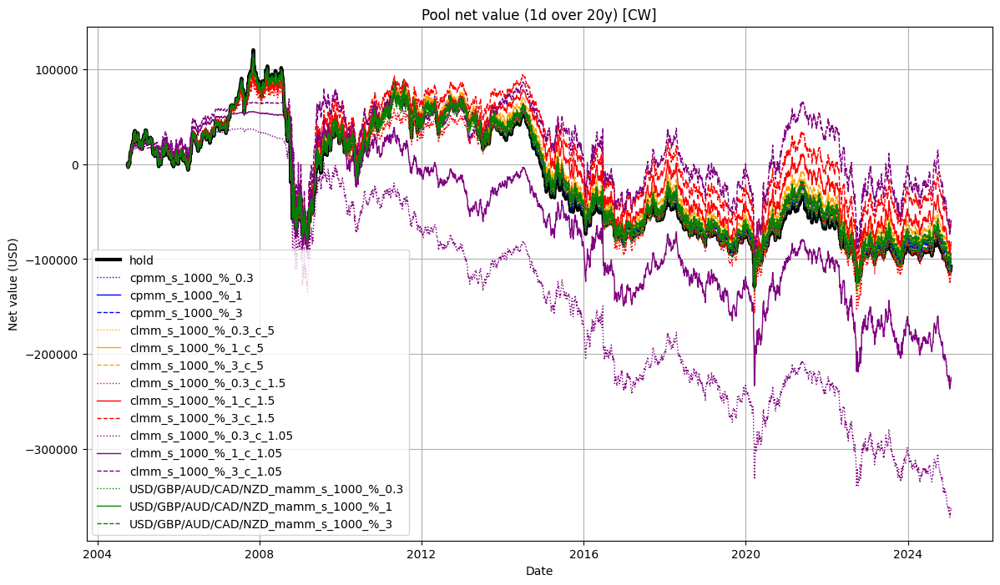

In [17]:
# print("full matrix list")
# print(matrix_list)

if False:
  print("individual matrixes")
  for matrix in matrix_list:
      # print(matrix)
      pool_name = matrix["pool_name"]  # Extract pool name
      data_df = matrix["data"]  # Extract the actual DataFrame
      if False:
        if pool_name == "USD/GBP":
          # Ensure Pandas displays all rows and columns
          pd.set_option("display.max_rows", None)
          pd.set_option("display.max_columns", None)
        else:
          pd.reset_option("display.max_rows")
          pd.reset_option("display.max_columns")

      # Print the full DataFrame
      #print(data_df)

      # Compute summary statistics only for numeric columns
      summary_stats = data_df.select_dtypes(include=['number']).agg(["min", "max", "median", "mean"])

      # Display the result with pool name
      print(f"\nSummary statistics for {pool_name}:")
      print(summary_stats)

  for table in starting_tables:
    pretty_print_table(table)

# Filter pools with only one "/" in their name
individual_pools = [pool for pool in matrix_list if pool['pool_name'].count('/') == 1]

# Extract the dataframes from the filtered pools
dataframes = [pool['data'] for pool in individual_pools]

# Sum the dataframes together, respecting column and row names
result_df = pd.concat(dataframes).groupby(level=0).sum()

mamm_pools = [pool for pool in matrix_list if pool['pool_name'].count('/') > 1]
for pool in mamm_pools:
    # Rename columns to include the pool_name for clarity
    pool_df = pool['data'].add_prefix(f"{pool['pool_name']}_")
    # Merge with result_df on the date index
    result_df = result_df.join(pool_df, on='date', how='outer')

# Output the result
pd.set_option('display.float_format', '{:,.4f}'.format)
output_df = pd.DataFrame(result_df)

if True:
    filtered_columns = [col for col in output_df.columns if not ("/" in col and "hold" in col)]
    output_df = output_df[filtered_columns]


print(output_df)

if False:
  summary_stats = output_df.agg({
      "hold": ["min", "max", "median", "mean"],
      "cpmm, s: 1000, %: 1": ["min", "max", "median", "mean"],
      "clmm, s: 1000, %: 1": ["min", "max", "median", "mean"],
      "USD/GBP/AUD/CAD/NZD_hold": ["min", "max", "median", "mean"],
      "USD/GBP/AUD/CAD/NZD_mamm, s: 1000, %: 1": ["min", "max", "median", "mean"]
  })
  print(summary_stats)

display_df = output_df - total_pool

# Define specific colors based on type keywords
custom_colors = {
    "cpmm": "blue",
    "mamm": "green",
    "clmm_5": "orange",
    "clmm_1.5": "red",
    "clmm_1.05": "purple"
}

# Assign line styles and colors
line_styles = {}
colors = {}
line_widths = {}

for column in display_df.columns:
    # Assign colors based on keyword matching
    if "cpmm" in column:
        colors[column] = custom_colors["cpmm"]
    elif "mamm" in column:
        colors[column] = custom_colors["mamm"]
    elif "clmm" in column:
        if "_5" in column:
            colors[column] = custom_colors["clmm_5"]
        elif "_1.5" in column:
            colors[column] = custom_colors["clmm_1.5"]
        elif "_1.05" in column:
            colors[column] = custom_colors["clmm_1.05"]
        else:
            colors[column] = "gray"  # Default for unspecified CLMM variations

    # Assign line styles
    if "hold" in column:
        colors[column] = "black"  # Holds should be black
        line_styles[column] = "-"  # Solid line for hold
        line_widths[column] = 3
    elif "%_0.3" in column:
        line_styles[column] = ":"  # Dotted line
        line_widths[column] = 1  # Default line width
    elif "%_1" in column:
        line_styles[column] = "-"  # Solid line
        line_widths[column] = 1  # Default line width
    elif "%_3" in column:
        line_styles[column] = "--"  # Dashed line
        line_widths[column] = 1  # Default line width
    else:
        line_styles[column] = "-"  # Default to solid
        line_widths[column] = 1  # Default line width

# Plot the filtered data
plt.figure(figsize=(14, 8))
for column in display_df.columns:
    plt.plot(display_df.index, display_df[column], 
             label=column, 
             color=colors[column], 
             linestyle=line_styles[column], 
             linewidth=line_widths[column])  # Use linewidth to make "hold" bold

# Formatting the plot
plt.xlabel("Date")
plt.ylabel(f"Net value ({base_asset})")
plt.title(f"Pool net value ({time_interval} over {time_period}) [{region}]")
plt.legend()
plt.grid(True)

# Display the plot
plt.show()

In [18]:
if False:
    for matrix in matrix_list:
        print(f"=== Matrix for {matrix['pool_name']} ===")
        # Print end_table
        print("\n--- End Tables ---")
        for variation, table in matrix['end_table'].items():
            print(f"\nVariation: {variation}")
            print(table.to_string())

    for matrix in matrix_list:
        print(f"=== Matrix for {matrix['pool_name']} ===")
        # Print summary
        print("\n--- Summary ---")
        for variation, summary in matrix['summary'].items():
            print(f"\nVariation: {variation}")
            print(summary)

if False:
    # Show all rows and columns
    pd.set_option("display.max_rows", None)
    pd.set_option("display.max_columns", None)
    pd.DataFrame(display_df)

In [19]:
aggregated_end_tables = {} # Create an ordered dictionary to store aggregated end tables
aggregated_summaries = {} # Create an ordered dictionary to store aggregated summaries

# Iterate over matrices to aggregate end tables
for matrix in matrix_list:
    pool_name = matrix["pool_name"]
    for variation, summary in matrix["summary"].items():
        #print(f"gets here2: variation: {variation}")
        if variation == "hold":
            #print(f"pool_name: {pool_name}")
            if variation not in aggregated_summaries and pool_name.count('/') > 1:
                aggregated_summaries[variation] = {
                    "Type": summary["Type"],
                    "Order Size": "no",
                    "Fee %": "no",
                    "Final_Pool_Value": summary["Final_Pool_Value"],
                    "Fees": summary["Fees"],
                    "Trades": summary["Trades"],
                }
                #print("added this")
                #print(added_summary)

                #aggregated_summaries[variation] = added_summary
        else:
            if variation not in aggregated_summaries:
                aggregated_summaries[variation] = {
                    "Type": summary["Type"],
                    "Order Size": summary["Order Size"],
                    "Fee %": summary["Fee %"],
                    "Final_Pool_Value": summary["Final_Pool_Value"],
                    "Fees": summary["Fees"],
                    "Trades": summary["Trades"],
                }
            else:
                # Sum up numerical values
                aggregated_summaries[variation]["Final_Pool_Value"] += summary["Final_Pool_Value"]
                aggregated_summaries[variation]["Fees"] += summary["Fees"]
                aggregated_summaries[variation]["Trades"] += summary["Trades"]

    for variation, table in matrix["end_table"].items():
        if variation == "hold" and table["type"].iloc[1] == "mamm":
            pass
        else:
            # Create a key based on variation name to aggregate variations separately
            key = f"{variation}"

            if key not in aggregated_end_tables:
                aggregated_end_tables[key] = []

            # Append the table to the corresponding variation
            aggregated_end_tables[key].append(table)

# Now combine all tables for each variation
combined_end_tables = {}
for variation, tables in aggregated_end_tables.items():
    combined_table = pd.concat(tables, axis=0)

    # Use OrderedDict to preserve the order of assets and drop duplicates
    ordered_assets = OrderedDict.fromkeys(combined_table.index)
    ordered_assets_list = list(ordered_assets.keys())

    # Filter to maintain the order
    combined_table = combined_table.loc[ordered_assets_list]

    # Group by asset to sum balances and values, keeping spot rates and recalculating weights
    combined_table = combined_table.groupby(level=0, sort=False).agg(
        {
            "weight": "sum",  # Will be recalculated later
            "spot": "first",  # Keep original spot rates
            "value": "sum",  # Sum values across tables
            "balance": "sum",  # Sum balances across tables
        }
    )

    # Recalculate weights based on the new total value
    total_value = combined_table["value"].sum()
    combined_table["weight"] = combined_table["value"] / total_value

    # Store the combined table
    combined_end_tables[variation] = combined_table

"""
#print(combined_end_tables)
pd.reset_option("display.width") 
print(pd.DataFrame(aggregated_summaries).T)
print()
"""

# Reorder the aggregated_summaries dictionary to ensure "hold" is first
ordered_summaries = {"hold": aggregated_summaries.pop("hold")} if "hold" in aggregated_summaries else {}
ordered_summaries.update(aggregated_summaries)

pd.set_option("display.width", 200)
print(pd.DataFrame(ordered_summaries).T)
print()

print("Tables")
for starting_table in starting_tables:
    if starting_table["type"].iloc[1] == "mamm":
        print("starting_table")
        pretty_print_table(starting_table.drop(columns=["type"]))
        print()

for variation, combined_table in combined_end_tables.items():
    #print(f"\nVariation: {display_table[variation]}")
    print(f"variation: {variation}")
    #print(combined_table)
    pretty_print_table(combined_table)
    print()


                          Type Order Size  Fee % Final_Pool_Value         Fees Trades
hold                      hold         no     no     892,341.6757            0      0
cpmm_s_1000_%_0.3         cpmm       1000 0.3000     892,018.8783   8,506.3867   2837
cpmm_s_1000_%_1           cpmm       1000      1     898,546.0928  15,683.9569   1570
cpmm_s_1000_%_3           cpmm       1000      3     903,555.9322  21,095.9446    705
clmm_s_1000_%_0.3_c_5     clmm       1000 0.3000     891,773.9686  15,510.5473   5173
clmm_s_1000_%_1_c_5       clmm       1000      1     903,904.8886  28,821.8475   2885
clmm_s_1000_%_3_c_5       clmm       1000      3     912,066.3269  37,638.7452   1258
clmm_s_1000_%_0.3_c_1.5   clmm       1000 0.3000     886,247.5852  39,625.5829  13215
clmm_s_1000_%_1_c_1.5     clmm       1000      1     917,873.2606  73,711.0553   7378
clmm_s_1000_%_3_c_1.5     clmm       1000      3     939,932.3115  97,027.7768   3243
clmm_s_1000_%_0.3_c_1.05  clmm       1000 0.3000     6